In [5]:
import sys
import os

path = os.path.dirname(os.path.abspath("__file__"))
sys.path.insert(0, path + '/../')

from util.io import log_files
import importlib
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(rc={"figure.dpi":150, 'savefig.dpi':300})
sns.set_context('paper')

import numpy as np
import pandas as pd

from IPython.display import set_matplotlib_formats
set_matplotlib_formats('retina')

_ = importlib.reload(log_files)

/var/folders/jr/mbdcmtbs4pg2gc3l8smjgd100000gn/T/ipykernel_65265/1966077614.py:18: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  set_matplotlib_formats('retina')


## Logs with deterministic embeddings 

In [8]:
log_date = '29-04-22'
# log_date = '13-03-22'

df = pd.concat([
    log_files.get_event_dataframe(
        log_dir,
        tags=['eval_reconstruction_loss',
              'eval_wasserstein_regularizer',
              'local_reward_loss',
              'local_transition_loss',
              'local_transition_loss_empirical_transition_function',
              'steady_state_regularizer',
              'transition_loss',
              'policy_evaluation_avg_rewards',
              'value_diff_empirical_latent_transition_function',
              'value_diff_latent_transition_function'],
        run_name='{}_encoder'.format('deterministic'),
        event_name=env,
    ) for env, log_dir in {
        'CartPole': '/Users/florentdelgrange/workspace/wae_mdp/log/{}/CartPole-v0/**/*.v2'.format(log_date),
        'MountainCar': '/Users/florentdelgrange/workspace/wae_mdp/log/{}/MountainCar-v0//**/*.v2'.format(log_date),
        'Acrobot': '/Users/florentdelgrange/workspace/wae_mdp/log/{}/Acrobot-v1/**/*.v2'.format(log_date),
        'Pendulum': '/Users/florentdelgrange/workspace/wae_mdp/log/{}/PendulumRandomInit-v1/**/*.v2'.format(log_date),
        'LunarLanderContinuous': '/Users/florentdelgrange/workspace/wae_mdp/log/{}/LunarLanderContinuous-v2/**/*.v2'.format(log_date),
    }.items()],
    ignore_index=True)

df

/Users/florentdelgrange/workspace/wae_mdp/evaluation/../util/io/log_files.py:76: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = data if df is None else df.append(data)
/Users/florentdelgrange/workspace/wae_mdp/evaluation/../util/io/log_files.py:76: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = data if df is None else df.append(data)
/Users/florentdelgrange/workspace/wae_mdp/evaluation/../util/io/log_files.py:76: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = data if df is None else df.append(data)
/Users/florentdelgrange/workspace/wae_mdp/evaluation/../util/io/log_files.py:76: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  d

,step,value,tag,run,event
0,369800,0.394135,transition_loss,deterministic_encoder,CartPole
1,369800,0.130105,steady_state_regularizer,deterministic_encoder,CartPole
2,370000,200.000000,policy_evaluation_avg_rewards,deterministic_encoder,CartPole
3,370000,0.111964,eval_reconstruction_loss,deterministic_encoder,CartPole
4,370000,13.169074,eval_wasserstein_regularizer,deterministic_encoder,CartPole
...,...,...,...,...,...
241087,759600,0.330794,transition_loss,deterministic_encoder,LunarLanderContinuous
241088,759600,0.365021,steady_state_regularizer,deterministic_encoder,LunarLanderContinuous
241089,759800,0.331275,transition_loss,deterministic_encoder,LunarLanderContinuous
241090,759800,0.365164,steady_state_regularizer,deterministic_encoder,LunarLanderContinuous


In [9]:
vae_df = pd.concat([
    log_files.get_event_dataframe(
        log_dir,
        tags=['policy_evaluation_avg_rewards', 'local_probability_loss'],
        run_name='VAE-MDP',
        event_name=env,
    ) for env, log_dir in {
        'CartPole': '/Users/florentdelgrange/workspace/wae_mdp/log/2021-08-25/CartPole-v0/**/*.v2',
        'MountainCar': '/Users/florentdelgrange/workspace/wae_mdp/log/2021-08-25/MountainCar-v0/**/*.v2',
        'Acrobot': '/Users/florentdelgrange/workspace/wae_mdp/log/2021-08-25/Acrobot-v1/**/*.v2',
        'Pendulum': '/Users/florentdelgrange/workspace/wae_mdp/log/2021-08-31/PendulumRandomInit-v0/**/*.v2',
        'LunarLanderContinuous': '/Users/florentdelgrange/workspace/wae_mdp/log/2021-08-31/LunarLanderContinuous-v2/**/*.v2',
    }.items()],
    ignore_index=True)

vae_df = vae_df[vae_df['step'] <= int(1e6)]

/Users/florentdelgrange/workspace/wae_mdp/evaluation/../util/io/log_files.py:76: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = data if df is None else df.append(data)
/Users/florentdelgrange/workspace/wae_mdp/evaluation/../util/io/log_files.py:76: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = data if df is None else df.append(data)
/Users/florentdelgrange/workspace/wae_mdp/evaluation/../util/io/log_files.py:76: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = data if df is None else df.append(data)
/Users/florentdelgrange/workspace/wae_mdp/evaluation/../util/io/log_files.py:76: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  d

In [10]:
hist = None


embedding = 'deterministic'
logs = {
    'CartPole': '/Users/florentdelgrange/workspace/wae_mdp/log/{}/CartPole-v0/*seed=1111*/**/*.v2'.format(log_date),
    'MountainCar': '/Users/florentdelgrange/workspace/wae_mdp/log/{}/MountainCar-v0/*seed=1111*/**/*.v2'.format(log_date),
    'Acrobot': '/Users/florentdelgrange/workspace/wae_mdp/log/{}/Acrobot-v1/*seed=111*/**/*.v2'.format(log_date),
    'Pendulum': '/Users/florentdelgrange/workspace/wae_mdp/log/{}/PendulumRandomInit-v1/*seed=1111*/**/*.v2'.format(log_date),
    'LunarLanderContinuous': '/Users/florentdelgrange/workspace/wae_mdp/log/{}/LunarLanderContinuous-v2/*seed=11111111*/**/*.v2'.format(log_date),
}

for env, log_dir in logs.items():
    _hist = log_files.get_event_dataframe(
        log_dir,
        tags=['state_frequency'],
        run_name='{}_encoder'.format(embedding),
        event_name=env,
        value_dtype=None)
    hist = _hist if hist is None else hist.append(_hist)

/var/folders/jr/mbdcmtbs4pg2gc3l8smjgd100000gn/T/ipykernel_65265/417824170.py:20: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hist = _hist if hist is None else hist.append(_hist)
/var/folders/jr/mbdcmtbs4pg2gc3l8smjgd100000gn/T/ipykernel_65265/417824170.py:20: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hist = _hist if hist is None else hist.append(_hist)
/var/folders/jr/mbdcmtbs4pg2gc3l8smjgd100000gn/T/ipykernel_65265/417824170.py:20: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hist = _hist if hist is None else hist.append(_hist)
/Users/florentdelgrange/workspace/wae_mdp/evaluation/../util/io/log_files.py:76: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use

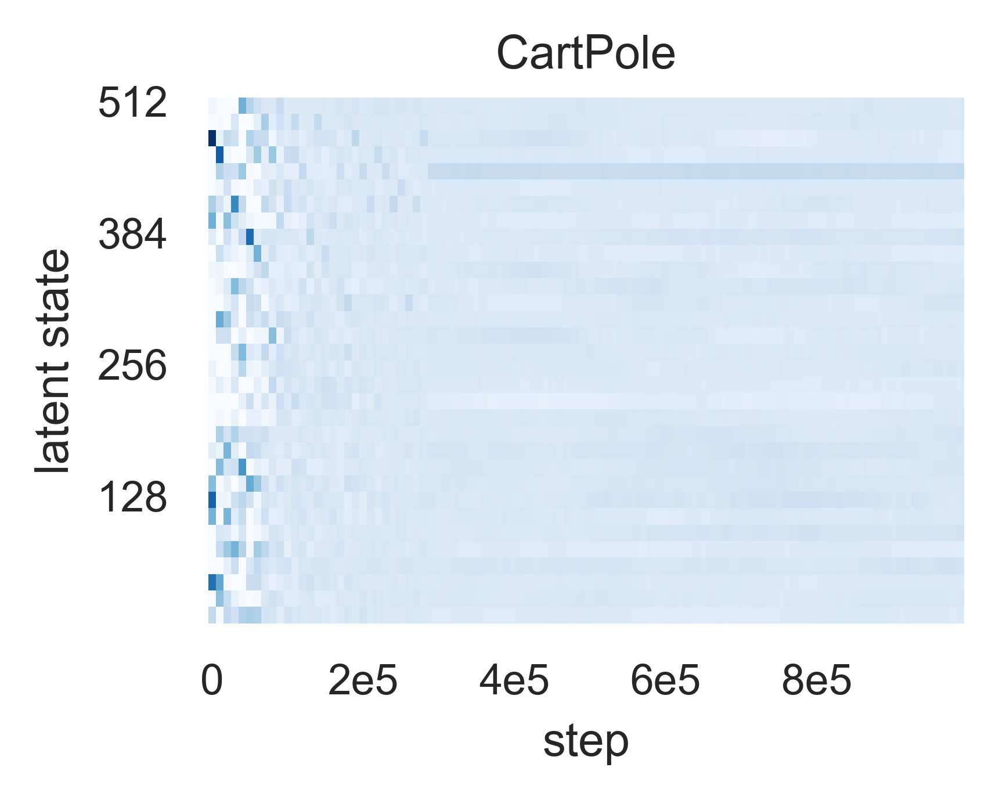

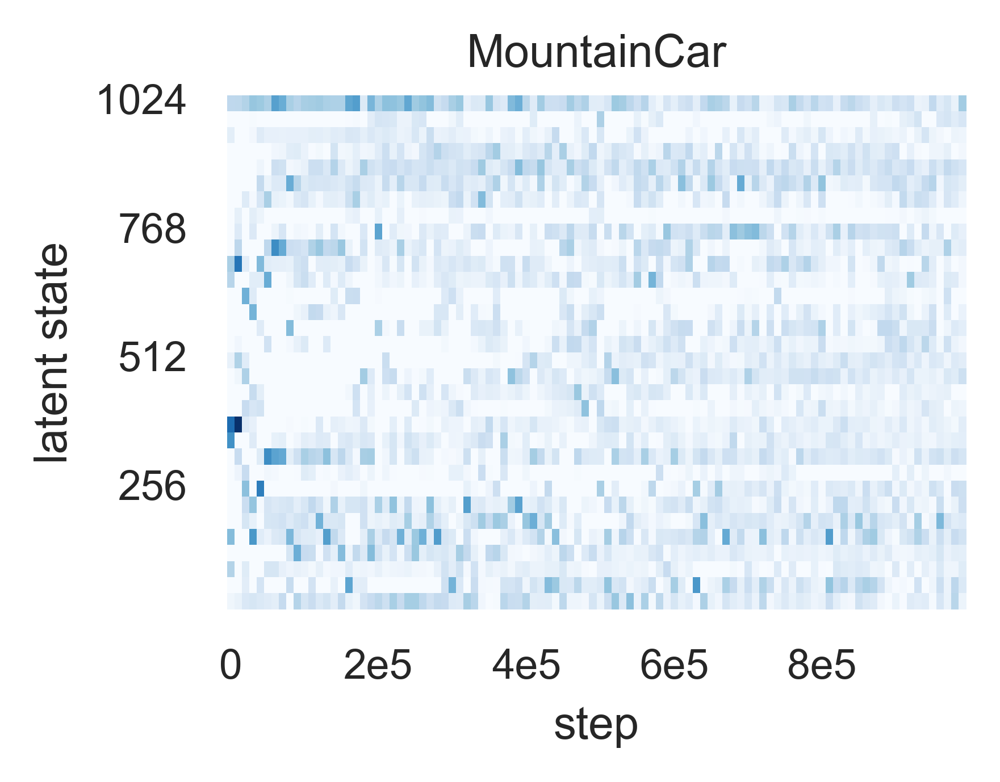

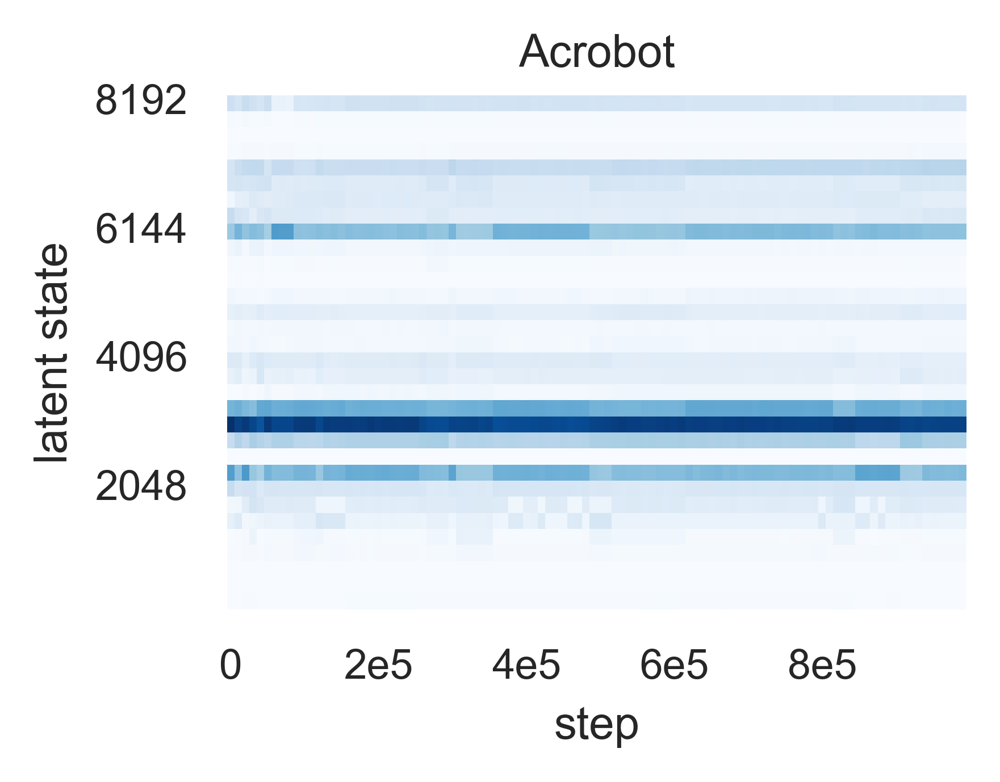

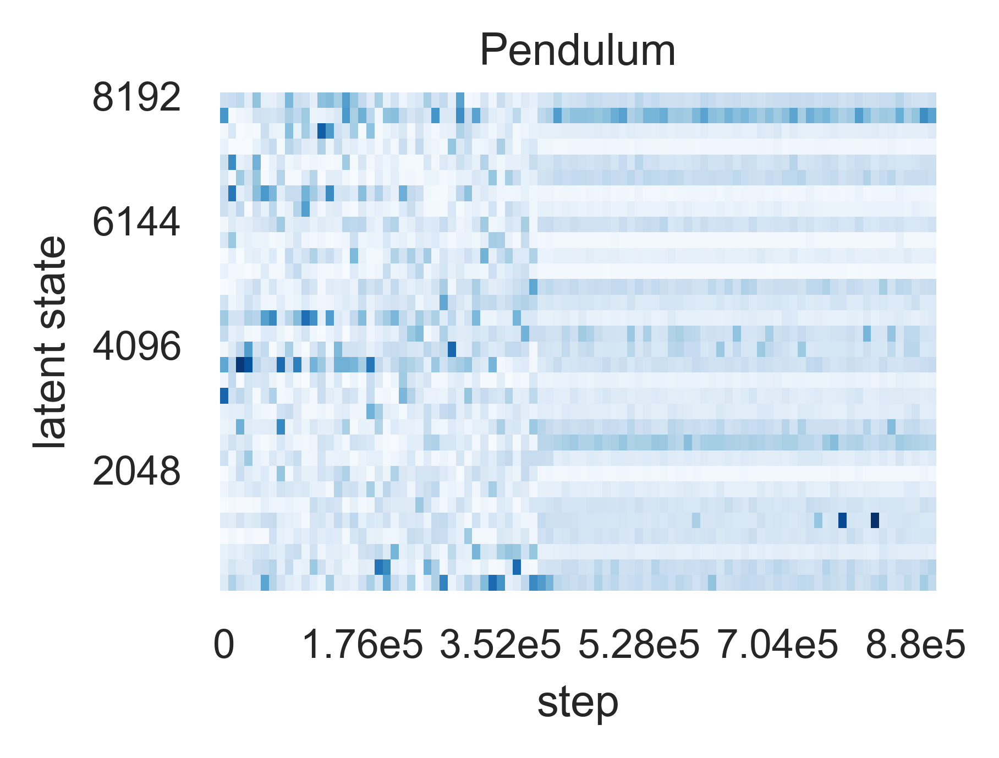

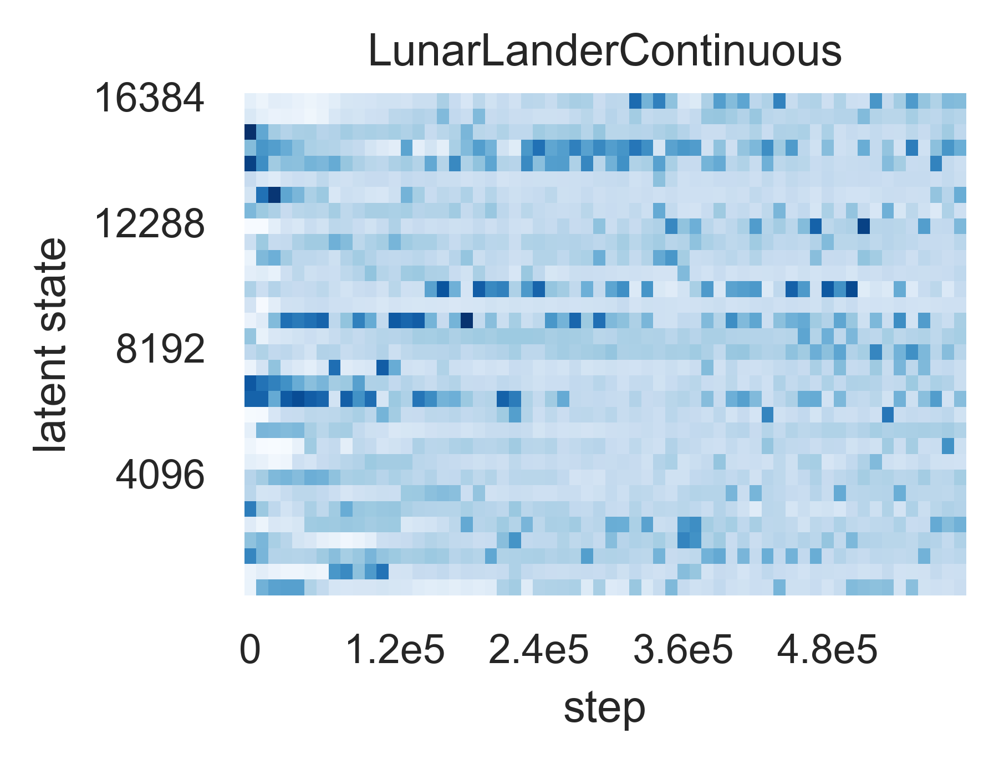

In [11]:
importlib.reload(log_files)

plt.rcParams['figure.dpi'] = 300

# sns.set_context('paper')

for environment in logs.keys():
    g = log_files.plot_histograms_per_step(
        hist[hist['event'] == environment],
        num_x_ticks=5, num_y_ticks=4,
        aspect=2,)

plt.savefig('cartpole_histogram.pdf', bbox_inches='tight')

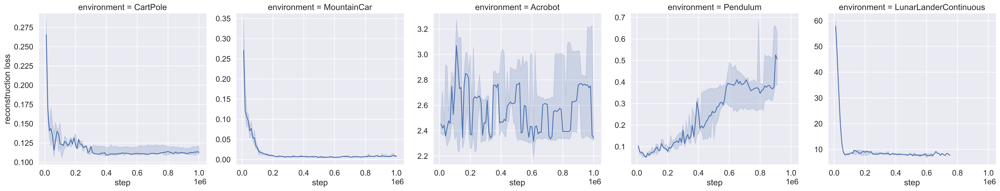

In [12]:
sns.set_context('paper')
sns.set(font_scale=1.25)
sns.relplot(
    data=df[df['tag'] == 'eval_reconstruction_loss'].rename(
        columns={
            "value": 'reconstruction loss',
            "run": "embedding",
            "event": "environment"}
    ).replace({
        'deterministic_embedding': 'deterministic',
        'stochastic_embedding': 'stochastic'}),
    x='step',
    y='reconstruction loss',
    # row='embedding',
    col='environment',
    facet_kws=dict(sharex=True, sharey=False),
    ci=85,
    estimator=np.median,
    kind='line',
    aspect=1.,)

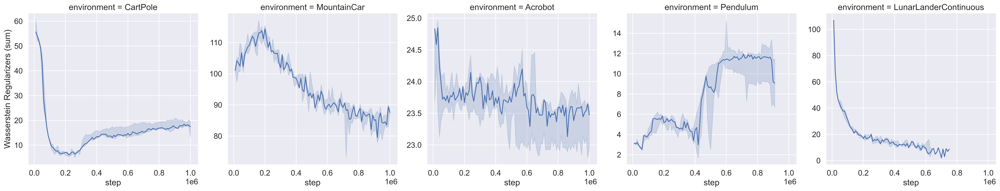

In [13]:
sns.set_context('paper')
sns.set(font_scale=1.25)
sns.relplot(
    data=df[df['tag'] == 'eval_wasserstein_regularizer'].rename(
        columns={
            "value": 'Wasserstein Regularizers (sum)',
            "run": "embedding",
            "event": "environment"}
    ).replace({
        'deterministic_embedding': 'deterministic',
        'stochastic_embedding': 'stochastic'}),
    x='step',
    y='Wasserstein Regularizers (sum)',
    # row='embedding',
    col='environment',
    facet_kws=dict(sharex=True, sharey=False),
    ci=85,
    estimator=np.median,
    kind='line',
    aspect=1.,)

In [47]:
_df = pd.concat(
        df[df['tag'] == tag] for tag in [
            'transition_loss',
            'local_transition_loss',
            'local_transition_loss_empirical_transition_function'])

sns.set_context('paper')
sns.set(font_scale=1.)
sns.relplot(
    data=_df[_df['step'] % int(1e4) == 0].rename(
        columns={
            "value": 'loss',
            "run": "encoder",
            "event": "environment",
            "tag": "transition loss"}
    ).replace({
        # 'deterministic_embedding': 'deterministic',
        # 'stochastic_embedding': 'stochastic',
        'transition_loss': 'training',
        'local_transition_loss': 'PAC',
        'local_transition_loss_empirical_transition_function': 'PAC (empirical transition function)'}),
    x='step',
    y='loss',
    # row='embedding',
    col='environment',
    hue='transition loss',
    facet_kws=dict(sharex=True, sharey=True),
    ci=80,
    estimator=np.median,
    kind='line',
    aspect=1.,)

In [14]:
_df = pd.concat(
        df[df['tag'] == tag] for tag in [
            'transition_loss',
            'local_transition_loss',
            'local_transition_loss_empirical_transition_function'])
_df['model'] = 'WAE'
_vae_df = vae_df[vae_df['tag'] == 'local_probability_loss']
_vae_df['model'] = 'VAE'
_vae_df_copy = _vae_df.copy()
# _vae_df['run'] = 'deterministic_embedding'
# _vae_df_copy['run'] = 'stochastic_embedding'
_df = pd.concat([_df, _vae_df, _vae_df_copy], ignore_index=True)

sns.set_context('paper')
sns.set(font_scale=1.)
sns.relplot(
    data=_df[_df['step'] % int(1e4) == 0].rename(
        columns={
            "value": 'loss',
            "run": "encoder",
            "event": "environment",
            "tag": "transition loss"}
    ).replace({
        # 'deterministic_embedding': 'deterministic',
        # 'stochastic_embedding': 'stochastic',
        'transition_loss': 'training',
        'local_transition_loss': 'PAC',
        'local_transition_loss_empirical_transition_function': 'PAC (empirical transition function)',
        'local_probability_loss': 'PAC (det. embedding, empirical transition function)'}),
    x='step',
    y='loss',
    # row='embedding',
    col='environment',
    style='model',
    hue='transition loss',
    facet_kws=dict(sharex=True, sharey=True),
    ci=80,
    estimator=np.median,
    kind='line',
    aspect=1.,)

/var/folders/jr/mbdcmtbs4pg2gc3l8smjgd100000gn/T/ipykernel_65265/1635927920.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  _vae_df['model'] = 'VAE'


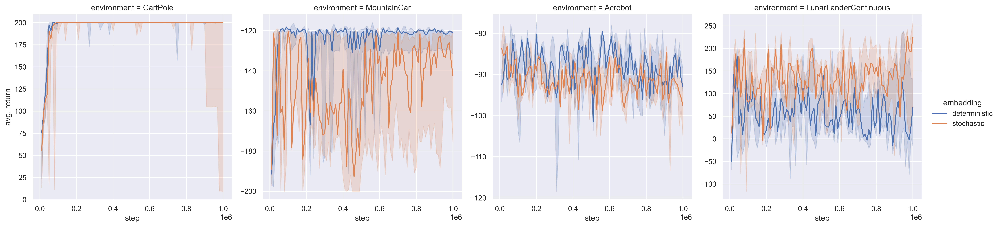

In [49]:
_df = pd.concat(
        df[df['tag'] == tag] for tag in [
            'policy_evaluation_avg_rewards'])

sns.set_context('paper')
sns.set(font_scale=1.)
sns.relplot(
    data=_df[_df['step'] % int(1e4) == 0].rename(
        columns={
            "value": 'avg. return',
            "run": "embedding",
            "event": "environment",}
    ).replace({
        'deterministic_embedding': 'deterministic',
        'stochastic_embedding': 'stochastic',}),
    x='step',
    y='avg. return',
    # row='embedding',
    col='environment',
    hue='embedding',
    facet_kws=dict(sharex=True, sharey=False),
    ci=80,
    estimator=np.median,
    kind='line',
    aspect=1.,)

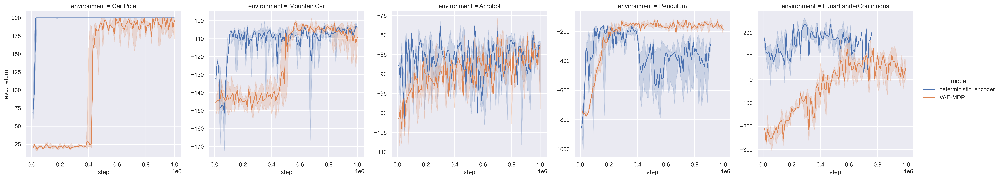

In [15]:
_df = pd.concat(
        df[df['tag'] == tag] for tag in [
            'policy_evaluation_avg_rewards'])
_vae_df = vae_df[vae_df['tag'] == 'policy_evaluation_avg_rewards']
_df = pd.concat([_df, _vae_df], ignore_index=True)

sns.set_context('paper')
sns.set(font_scale=1.)
sns.relplot(
    data=_df[_df['step'] % int(1e4) == 0].rename(
        columns={
            "value": 'avg. return',
            "run": "model",
            "event": "environment",}),
    x='step',
    y='avg. return',
    # row='embedding',
    col='environment',
    hue='model',
    facet_kws=dict(sharex=True, sharey=False),
    ci=80,
    estimator=np.median,
    kind='line',
    aspect=1.,)

-------

In [29]:
log_date = '23-03-22'

df = pd.concat([
    pd.concat([
        log_files.get_event_dataframe(
            log_dir,
            tags=['policy_evaluation_avg_rewards',],
            run_name='{}'.format(key),
            event_name=env,
        ) for env, log_dir in {
            'Pendulum':
            '/Users/florentdelgrange/workspace/wae_mdp/log/{}/PendulumRandomInit-v1/*{}*{}*/**/*{}*/**/*.v2'.format(
                log_date,  hyperparams['optimizer1'],  hyperparams['optimizer2'], hyperparams['embedding'])
        }.items()
    ], ignore_index=True) for key, hyperparams in {
        '#1: Adam, Adam, deterministic embedding': {
            'optimizer1': 'Adam_lr=0.0001',
            'optimizer2': 'Adam_lr=0.0001',
            'embedding': 'deterministic'
        },
        '#2: Adam, RMSprop, stochastic embedding': {
            'optimizer1': 'Adam_lr=0.0001',
            'optimizer2': 'RMSprop_lr=0.00038',
            'embedding': 'stochastic'
        },
        '#3: Adam, RMSprop, deterministic embedding': {
            'optimizer1': 'Adam_lr=0.0003',
            'optimizer2': 'RMSprop_lr=0.00038',
            'embedding': 'deterministic'
        }
    }.items()],
    ignore_index=True)

df

,step,value,tag,run,event
0,10000,-864.159485,policy_evaluation_avg_rewards,"#1: Adam, Adam, deterministic embedding",Pendulum
1,20000,-990.724915,policy_evaluation_avg_rewards,"#1: Adam, Adam, deterministic embedding",Pendulum
2,30000,-891.640625,policy_evaluation_avg_rewards,"#1: Adam, Adam, deterministic embedding",Pendulum
3,40000,-948.672729,policy_evaluation_avg_rewards,"#1: Adam, Adam, deterministic embedding",Pendulum
4,50000,-656.844360,policy_evaluation_avg_rewards,"#1: Adam, Adam, deterministic embedding",Pendulum
...,...,...,...,...,...
1232,800000,-361.217438,policy_evaluation_avg_rewards,"#2: Adam, RMSprop, deterministic embedding",Pendulum
1233,810000,-406.415222,policy_evaluation_avg_rewards,"#2: Adam, RMSprop, deterministic embedding",Pendulum
1234,820000,-184.547043,policy_evaluation_avg_rewards,"#2: Adam, RMSprop, deterministic embedding",Pendulum
1235,830000,-194.423798,policy_evaluation_avg_rewards,"#2: Adam, RMSprop, deterministic embedding",Pendulum


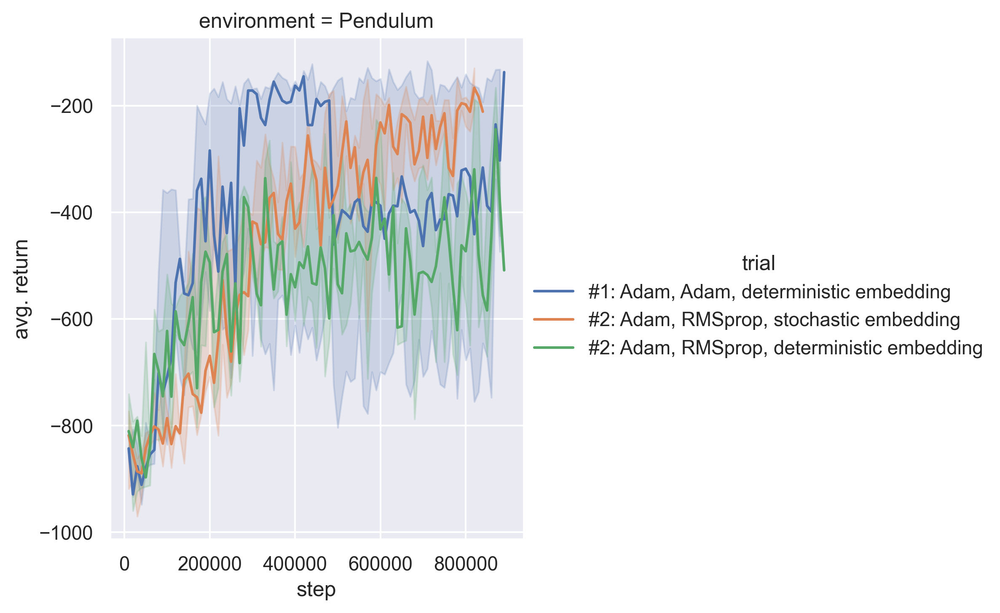

In [30]:
sns.set_context('paper')
sns.set(font_scale=1.)
sns.relplot(
    data=df[df['step'] % int(1e4) == 0].rename(
        columns={
            "value": 'avg. return',
            "run": "trial",
            "event": "environment",}),
    x='step',
    y='avg. return',
    # row='embedding',
    col='environment',
    hue='trial',
    facet_kws=dict(sharex=True, sharey=False),
    ci=70,
    estimator=np.median,
    kind='line',
    aspect=1.,)

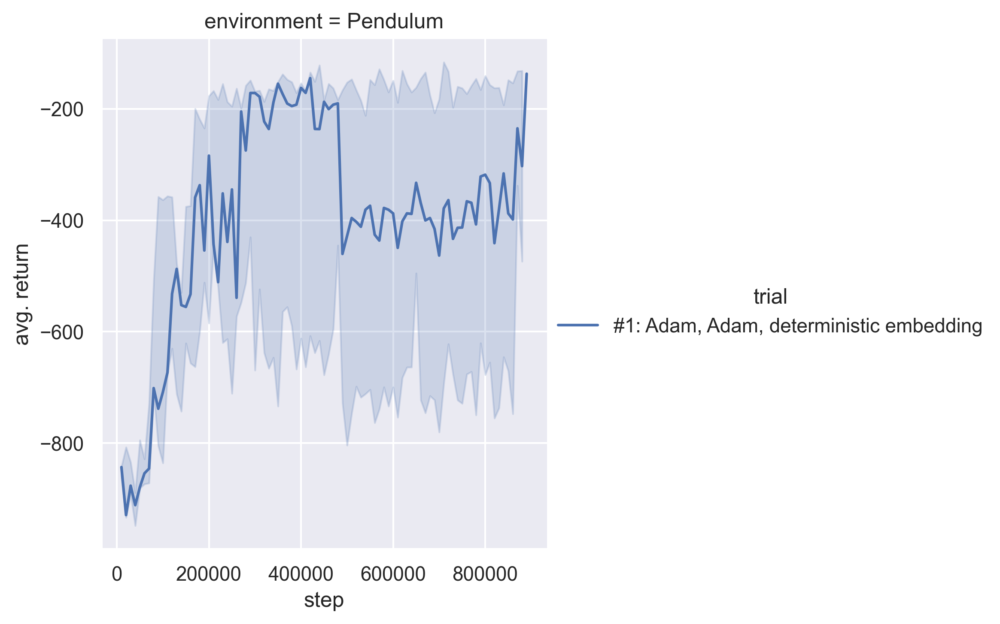

In [35]:
sns.set_context('paper')
sns.set(font_scale=1.)
sns.relplot(
    data=df[df['run'] == '#1: Adam, Adam, deterministic embedding'].rename(
        columns={
            "value": 'avg. return',
            "run": "trial",
            "event": "environment",}),
    x='step',
    y='avg. return',
    # row='embedding',
    col='environment',
    hue='trial',
    facet_kws=dict(sharex=True, sharey=False),
    ci=70,
    estimator=np.median,
    kind='line',
    aspect=1.,)